# longyearbyen_test

In [1]:
%load_ext autoreload
%autoreload 2
from oogeso.io import file_io
import oogeso.plots as plots
from oogeso.utils import create_time_series_data
import oogeso.dto
import matplotlib.pyplot as plt
import IPython.display
#import numpy as np
import pandas as pd
import logging
import pprint
import ipywidgets
import pickle
import plotly.express as px
import pyomo.environ as pyo
from dataclasses import asdict

logging.basicConfig()
logger = logging.getLogger()
logger.setLevel('INFO') #INFO

## Read input data

In [2]:
"""Select case"""

#case="_diesel_only_2018"
#case="_diesel_battery_2018"
#case="_diesel_battery_pv_2018"
#case="_br_onshore_small_2018"
#case="_br_onshore_full_2018"
case="_ir_offshore_limited_2018"
#case="_ir_offshore_full_2018"
#case="_br_fully_renewable_2018"


"""Run, Save or load"""

run_case = True
save_case = True
load_case = False
if not run_case and not load_case:
    raise Exception("At least one of run_case and load_case must be True.")
if save_case and not run_case:
    raise Exception("When save_case is True, run_case must also be True.")


"""Output location and input data file"""

outpath = "result/"
data = file_io.read_data_from_yaml("../tests/test_data/longyearbyen_test.yaml")

In [3]:
# Define lists of device, edge, and node names defined in the input data file
dieselgenerators = ['backup_east_1','backup_east_2','backup_east_3','backup_west_1','backup_west_2','backup_west_3']
dieselboilers = ['diesel_boiler_1','diesel_boiler_2','boiler_houses']
dieselboilers_small = ['boiler_houses']
diesel_source = ["diesel_source"]
dieseldevices = dieselgenerators + dieselboilers + diesel_source + ['el_diesel_load', 'heat_diesel_load', 'diesel_backup']
powersupplydevices = ["powersupply", "el_ps_load", "heat_ps_load"]
batterydevices = ["el_storage"]
winddevices = ["wind", "wind_farm", "el_wf_ps"]
pvdevices = ["pv", "el_pv_ps"]
electricboilerdevices = ["electric_boiler", "el_ps_eb", "heat_eb_load"]
geothermaldevices = ["geothermal", "el_ps_geo", "heat_geo_load"]
hydrogenelectrolyser = ['electrolyser']
hydrogenfuelcell = ['fuelcell']
hydrogenstorage = ['h2_storage']
hydrogendevices = hydrogenelectrolyser + hydrogenfuelcell + hydrogenstorage + ['el_ps_h2','heat_h2_load']

In [4]:
"""Global model parameters"""

data.parameters.time_delta_minutes = 60 # minutes per timestep
data.parameters.planning_horizon = 240 # timesteps in each rolling optimisation
data.parameters.optimisation_timesteps = 24 # timesteps between each optimisation
data.parameters.forecast_timesteps = 24 # timesteps beyond which forecast (instead of nowcast) profile is used (forecast and nowcast are currently identical)
#time_reserve_minutes: 1440 # minutes, how long stored energy must be sustained to count as reserve
data.parameters.co2_tax = 2 # NOK/kgCO2 https://www.regjeringen.no/contentassets/4eeae826fa5c4e21ad186eec1d9b7873/no/pdfs/prp202120220001ls1dddpdfs.pdf
data.parameters.emission_intensity_max = -1 # kgCO2/Sm3oe, -1=no limit
data.parameters.emission_rate_max = -1 # kgCO2/hour, -1=no limit
data.parameters.objective = "costs" # select objective function to use

In [5]:
"""Cost and technology data based mainly on the Danish Energy Agency technology data sheet"""

euro_inflation_2015_2022 = 1.127
euro_inflation_2019_2022 = 1.087
euro_inflation_2020_2022 = 1.080
NOK_per_euro = 10.0
dollar_inflation_2013_2022 = 1.221
dollar_inflation_2018_2022 = 1.134
NOK_per_dollar = 8.81
NOK_inflation_2020_2022 = 1.0584
seconds_per_year = 3600 * 24 * 365
diesel_hhv_lhv_ratio = 1.063
h2_kWh_per_Nm3 = 12.7 / 3.6

# Diesel costs
diesel_fuel_cost = 7590 * NOK_inflation_2020_2022 # NOK/Nm3
diesel_generator_investment_cost = 0 # Already installed
diesel_generator_fixed_op_cost = 8800/seconds_per_year * euro_inflation_2015_2022 * NOK_per_euro # €/(MW*year) / s/year * inflation(€) * NOK/€ => NOK/(MW*s)
diesel_generator_op_cost = 6/3600 * euro_inflation_2015_2022 * NOK_per_euro # €/MWh / s/h * inflation(€) * NOK/€ => NOK/MWs
diesel_generator_lifetime = 20 # years
diesel_boiler_investment_cost = 0 # Already installed
diesel_boiler_fixed_op_cost = 1800/seconds_per_year * euro_inflation_2019_2022 * NOK_per_euro # €/(MW*year) / s/year * inflation(€) * NOK/€ => NOK/(MW*s)
diesel_boiler_op_cost = 1/3600 * euro_inflation_2019_2022 * NOK_per_euro # €/MWh / s/h * inflation(€) * NOK/€ => NOK/MWs
diesel_boiler_lifetime = 25 # years
diesel_boiler_eta = 0.94 / diesel_hhv_lhv_ratio # efficiency (hhv)
diesel_boiler_small_eta = 0.92 / diesel_hhv_lhv_ratio # efficiency (hhv)

# Battery costs
battery_investment_cost = 0 # Already installed (soon)
battery_fixed_op_cost = 540 / seconds_per_year * euro_inflation_2015_2022 * NOK_per_euro # €/(MW*year) / s/year * inflation(€) * NOK/€ => NOK/(MW*s)
battery_op_cost = 2/3600 * euro_inflation_2015_2022 * NOK_per_euro # €/MWh / s/h * inflation(€) * NOK/€ => NOK/MWs
battery_lifetime = 20 # years
battery_eta = 0.91 # efficiency

# Onshore wind costs
onshore_wind_investment_cost = 1.04 * 10**6 * euro_inflation_2015_2022 * NOK_per_euro # M€/MW * €/M€ * inflation(€) * NOK/€ => NOK/MW
onshore_wind_fixed_op_cost = 12600/seconds_per_year * euro_inflation_2015_2022 * NOK_per_euro # €/(MW*year) / s/year * inflation(€) * NOK/€ => NOK/(MW*s)
onshore_wind_op_cost = 1.35/3600 * euro_inflation_2015_2022 * NOK_per_euro # €/MWh / s/h * inflation(€) * NOK/€ => NOK/MWs
onshore_wind_lifetime = 30 # years

# Offshore wind costs
offshore_wind_investment_cost = 1.80 * 10**6 * euro_inflation_2020_2022 * NOK_per_euro # M€/MW * €/M€ * inflation(€) * NOK/€ => NOK/MW
offshore_wind_fixed_op_cost = 39000/seconds_per_year * euro_inflation_2020_2022 * NOK_per_euro # €/(MW*year) / s/year * inflation(€) * NOK/€ => NOK/(MW*s)
offshore_wind_op_cost = 3.9/3600 * euro_inflation_2020_2022 * NOK_per_euro # €/MWh / s/h * inflation(€) * NOK/€ => NOK/MWs
offshore_wind_lifetime = 30 # years

# Photovoltaic costs
pv_investment_cost = 0.57 * 10**6 * euro_inflation_2020_2022 * NOK_per_euro # M€/MW * €/M€ * inflation(€) * NOK/€ => NOK/MW
pv_fixed_op_cost = 8900/seconds_per_year * euro_inflation_2020_2022 * NOK_per_euro # €/(MW*year) / s/year * inflation(€) * NOK/€ => NOK/(MW*s)
pv_op_cost = 0/3600 * euro_inflation_2020_2022 * NOK_per_euro # €/MWh / s/h * inflation(€) * NOK/€ => NOK/MWs
pv_lifetime = 40 # years

# Electric boiler costs
eb_investment_cost = 0.14 * 10**6 * euro_inflation_2015_2022 * NOK_per_euro #M€/MW * €/M€ * inflation(€) * NOK/€ => NOK/MW
eb_fixed_op_cost = 1020/seconds_per_year * euro_inflation_2015_2022 * NOK_per_euro # €/(MW*year) / s/year * inflation(€) * NOK/€ => NOK/(MW*s)
eb_op_cost = 0.5/3600 * euro_inflation_2015_2022 * NOK_per_euro # €/MWh / s/h * inflation(€) * NOK/€ => NOK/MWs (Not el costs)
eb_lifetime = 20 # years

# Geothermal costs
geo_investment_cost = 2.69 * 10**6 * euro_inflation_2015_2022 * NOK_per_euro #M€/MW * €/M€ * inflation(€) * NOK/€ => NOK/MW
geo_fixed_op_cost = 22500/seconds_per_year * euro_inflation_2015_2022 * NOK_per_euro # €/(MW*year) / s/year * inflation(€) * NOK/€ => NOK/(MW*s)
geo_op_cost = 4.6/3600 * euro_inflation_2015_2022 * NOK_per_euro # €/MWh / s/h * inflation(€) * NOK/€ => NOK/MWs (Not el costs)
geo_lifetime = 40 # years
geo_eta = 4 # efficiency

# Hydrogen costs
h2_fuel_cell_investment_cost = 0.949 * 10**6 * dollar_inflation_2018_2022 * NOK_per_dollar #M$/MW * $/M$ * inflation($) * NOK/$ => NOK/MW
h2_fuel_cell_fixed_op_cost = 12800/seconds_per_year * dollar_inflation_2018_2022 * NOK_per_dollar # $/(MW*year) / s/year * inflation($) * NOK/$ => NOK/(MW*s)
h2_fuel_cell_op_cost = 0.5/3600 * dollar_inflation_2018_2022 * NOK_per_dollar # $/MWh / s/h * inflation($) * NOK/$ => NOK/MWs
h2_fuel_cell_lifetime = 30 # years
h2_fuel_cell_eta = 0.5 # 50 % of energy converted to electricity
h2_fuel_cell_eta_heat = 0.4 / (1 - h2_fuel_cell_eta) # % recovered total energy / amount of waste energy => % recovered waste energy
h2_electrolyser_investment_cost = 0.437 * 10**6 * dollar_inflation_2018_2022 * NOK_per_dollar #M$/MW * $/M$ * inflation($) * NOK/$ => NOK/MW
h2_electrolyser_fixed_op_cost = 12800/seconds_per_year * dollar_inflation_2018_2022 * NOK_per_dollar # $/(MW*year) / s/year * inflation($) * NOK/$ => NOK/(MW*s)
h2_electrolyser_op_cost = 0.5/3600 * dollar_inflation_2018_2022 * NOK_per_dollar # $/MWh / s/h * inflation($) * NOK/$ => NOK/MWs
h2_electrolyser_lifetime = 30 # years
h2_electrolyser_eta = 0.73 # Share of H2 HHV required for electrolysis
h2_electrolyser_eta_heat = 0.23 / (1 - h2_electrolyser_eta) # % recovered total energy / amount of waste energy => % recovered waste energy
h2_compressorstorage_investment_cost = 1 * h2_kWh_per_Nm3 * dollar_inflation_2013_2022 * NOK_per_dollar # $/kWh * kWh/Nm3 * inflation($) * NOK/$ => NOK/Nm3
h2_compressorstorage_fixed_op_cost = 0.01 * h2_compressorstorage_investment_cost / seconds_per_year # 1% of investment cost per year
h2_compressorstorage_op_cost = 0 # Zero variable operational costs
h2_compressorstorage_eta = 0.95 # motor efficiency
h2_compressorstorage_eta_heat = 0.9 # recovered energy difference between actual compreesion work and isothermal compression work
h2_compressorstorage_isothermal_adiabatic = 0.5 # actual compression work is this share of isothermal and (1 - this share) of adiabatic
h2_compressorstorage_p_in = 3 # MPa (30 bar). pressure of input hydrogen
h2_compressorstorage_temperature = 300 # Kelvin
h2_compressorstorage_p_max = 70 # MPa (700 bar)
h2_compressorstorage_lifetime = 20 # years

In [6]:
# Initially include no devices
incl_diesel=False
incl_battery=False
incl_wind=False
incl_pv=False
incl_electricboiler=False
incl_geothermal=False
incl_hydrogen=False

if case=="_diesel_only_2018":
    # Add included devices
    incl_diesel=True
    # Combine profiles
    load = pd.read_csv('../tests/test_data/LYR_load.csv')
    load.set_index(load["timestamp"], inplace=True)
    load = load['2018-01-01':]
    load.fillna(0,inplace=True)
    load.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    # Define timerange
    timerange = [0,min(24*365,len(load)-data.parameters.planning_horizon)]
    # Set the reserve margin requirement to 0 to make the problem feasible
    for carrier in data.carriers:
        if carrier.id == "el":
            carrier.el_reserve_margin = 0

if case=="_diesel_battery_2018":
    # Add included devices
    incl_diesel=True
    incl_battery=True
    # Combine profiles
    load = pd.read_csv('../tests/test_data/LYR_load.csv')
    load.set_index(load["timestamp"], inplace=True)
    load = load['2018-01-01':]
    load.fillna(0,inplace=True)
    load.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    # Define timerange
    timerange = [0,min(24*365,len(load)-data.parameters.planning_horizon)]
    # Set the reserve margin requirement to 0 to make the problem feasible
    for carrier in data.carriers:
        if carrier.id == "el":
            carrier.el_reserve_margin = 0

if case=="_diesel_battery_pv_2018":
    # Add included devices
    incl_diesel=True
    incl_battery=True
    incl_pv=True
    # Combine profiles
    first = pd.read_csv('../tests/test_data/LYR_load.csv')
    second = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
    merged = pd.merge(first, second, how='left', on='timestamp')
    merged.set_index(merged["timestamp"], inplace=True)
    merged = merged['2018-01-01':]
    merged.fillna(0,inplace=True)
    merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    # Define timerange
    timerange = [0,min(24*365,len(merged)-data.parameters.planning_horizon)]
    # Set PV values
    pv_P_max=25 # MWp, Sun on all roofs
    pv_profile="PV" # Sun profile
    # Set the reserve margin requirement to 0 to make the problem feasible
    for carrier in data.carriers:
        if carrier.id == "el":
            carrier.el_reserve_margin = 0

elif case=="_br_onshore_small_2018":
    # Add included devices
    incl_diesel=True
    incl_battery=True
    incl_wind=True
    incl_pv=True
    incl_electricboiler=True
    #incl_geothermal=True
    # Combine profiles
    first = pd.read_csv('../tests/test_data/LYR_load.csv')
    second = pd.read_csv('../tests/test_data/cap_factors_1hr_br_log.csv')
    third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
    #fourth = pd.read_csv('../tests/test_data/geothermal_supply_1hr.csv')[["timestamp","geothermal"]]
    merged = pd.merge(first, second, how='left', on='timestamp')
    merged = pd.merge(merged, third, how='left', on='timestamp')
    #merged = pd.merge(merged, fourth, how='left', on='timestamp')
    merged.set_index(merged["timestamp"], inplace=True)
    merged = merged['2018-01-01':]
    merged.fillna(0,inplace=True)
    merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    # Define timerange
    timerange = [0,min(24*365,len(merged)-data.parameters.planning_horizon)]
    # Set wind values
    wind_P_max=3.45*5 # MW, 10 Vestas V105 turbines
    wind_profile="V105" # wind profile name with Breinosa data
    wind_investment_cost = onshore_wind_investment_cost
    wind_fixed_op_cost = onshore_wind_fixed_op_cost
    wind_op_cost = onshore_wind_op_cost
    wind_lifetime = onshore_wind_lifetime
    # Set PV values
    pv_P_max=25 # MWp, Sun on all roofs
    pv_profile="PV" # Sun profile
    # Set Geothermal values
    #geothermal_P_max=1.3 # Wintertime max electrical input power
    #geothermal_profile="geothermal"
    
elif case=="_br_onshore_full_2018":
    # Add included devices
    incl_diesel=True
    incl_battery=True
    incl_wind=True
    incl_pv=True
    incl_electricboiler=True
    incl_geothermal=True
    incl_hydrogen=True
    # Combine profiles
    first = pd.read_csv('../tests/test_data/LYR_load.csv')
    second = pd.read_csv('../tests/test_data/cap_factors_1hr_br_log.csv')
    third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
    fourth = pd.read_csv('../tests/test_data/geothermal_supply_1hr.csv')[["timestamp","geothermal"]]
    merged = pd.merge(first, second, how='left', on='timestamp')
    merged = pd.merge(merged, third, how='left', on='timestamp')
    merged = pd.merge(merged, fourth, how='left', on='timestamp')
    merged.fillna(0,inplace=True)
    merged.set_index(merged["timestamp"], inplace=True)
    merged = merged['2018-01-01':]
    merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    # Define timerange
    timerange = [0,min(24*365,len(merged)-data.parameters.planning_horizon)]
    # Set wind values
    wind_P_max=3.45*10 # MW, 10 Vestas V105 turbines
    wind_profile="V105" # wind profile name with Breinosa data
    wind_investment_cost = onshore_wind_investment_cost
    wind_fixed_op_cost = onshore_wind_fixed_op_cost
    wind_op_cost = onshore_wind_op_cost
    wind_lifetime = onshore_wind_lifetime
    # Set PV values
    pv_P_max=25 # MWp, Sun on all roofs
    pv_profile="PV" # Sun profile
    # Set Geothermal values
    geothermal_P_max=1.3 # Wintertime max electrical input power
    geothermal_profile="geothermal"
    # Set hydrogen system values
    h2_electrolyser_flow_max = 40 # MW installed capacity
    h2_fuel_cell_flow_max = 10 # MW installed capacity
    h2_compressorstorage_E_max = 10**6 # 1 million Nm3
    h2_compressorstorage_E_init = 3*10**5 # 300 000 Nm3

elif case=="_ir_offshore_limited_2018":
    # Add included devices
    incl_diesel=True
    incl_battery=True
    incl_wind=True
    incl_pv=True
    incl_electricboiler=True
    incl_geothermal=True
    incl_hydrogen=True
    # Combine profiles
    first = pd.read_csv('../tests/test_data/LYR_load.csv')
    second = pd.read_csv('../tests/test_data/cap_factors_1hr_ir_log.csv')
    third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
    fourth = pd.read_csv('../tests/test_data/geothermal_supply_1hr.csv')[["timestamp","geothermal"]]
    merged = pd.merge(first, second, how='left', on='timestamp')
    merged = pd.merge(merged, third, how='left', on='timestamp')
    merged = pd.merge(merged, fourth, how='left', on='timestamp')
    merged.set_index(merged["timestamp"], inplace=True)
    merged = merged['2018-01-01':]
    merged.fillna(0,inplace=True)
    merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    # Define timerange
    timerange = [0,min(24*365,len(merged)-data.parameters.planning_horizon)]
    # Set wind values
    wind_P_max=3.45*5 # MW, 5 Vestas V105 turbines
    wind_profile="V105" # wind profile name with Isfjord radio data
    wind_investment_cost = offshore_wind_investment_cost
    wind_fixed_op_cost = offshore_wind_fixed_op_cost
    wind_op_cost = offshore_wind_op_cost
    wind_lifetime = offshore_wind_lifetime
    # Set PV values
    pv_P_max=25 # MWp, Sun on all roofs
    pv_profile="PV" # Sun profile
    # Set geothermal values
    geothermal_P_max=1.3 # Wintertime input power
    geothermal_profile="geothermal"
    # Set hydrogen system values
    h2_electrolyser_flow_max = 25 # MW installed capacity
    h2_fuel_cell_flow_max = 10 # MW installed capacity
    h2_compressorstorage_E_max = 1*10**6 # 1.75 million Nm3
    h2_compressorstorage_E_init = 0.1*10**6 # 300 000 Nm3

elif case=="_ir_offshore_full_2018":
    # Add included devices
    incl_diesel=True
    incl_battery=True
    incl_wind=True
    incl_pv=True
    incl_electricboiler=True
    incl_geothermal=True
    incl_hydrogen=True
    # Combine profiles
    first = pd.read_csv('../tests/test_data/LYR_load.csv')
    second = pd.read_csv('../tests/test_data/cap_factors_1hr_ir_log.csv')
    third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
    fourth = pd.read_csv('../tests/test_data/geothermal_supply_1hr.csv')[["timestamp","geothermal"]]
    merged = pd.merge(first, second, how='left', on='timestamp')
    merged = pd.merge(merged, third, how='left', on='timestamp')
    merged = pd.merge(merged, fourth, how='left', on='timestamp')
    merged.set_index(merged["timestamp"], inplace=True)
    merged = merged['2018-01-01':]
    merged.fillna(0,inplace=True)
    merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    # Define timerange
    timerange = [0,min(24*365,len(merged)-data.parameters.planning_horizon)]
    # Set wind values
    wind_P_max=3.45*7 # MW, 7 Vestas V105 turbines
    wind_profile="V105" # wind profile name with Isfjord radio data
    wind_investment_cost = offshore_wind_investment_cost
    wind_fixed_op_cost = offshore_wind_fixed_op_cost
    wind_op_cost = offshore_wind_op_cost
    wind_lifetime = offshore_wind_lifetime
    # Set PV values
    pv_P_max=25 # MWp, Sun on all roofs
    pv_profile="PV" # Sun profile
    # Set geothermal values
    geothermal_P_max=1.3 # Wintertime input power
    geothermal_profile="geothermal"
    # Set hydrogen system values
    h2_electrolyser_flow_max = 35 # MW installed capacity
    h2_fuel_cell_flow_max = 10 # MW installed capacity
    h2_compressorstorage_E_max = 1.75*10**6 # 1.75 million Nm3
    h2_compressorstorage_E_init = 0.3*10**6 # 300 000 Nm3

elif case=="_br_fully_renewable_2018":
    # Add included devices
    incl_diesel=True
    incl_battery=True
    incl_wind=True
    incl_pv=True
    incl_electricboiler=True
    incl_geothermal=True
    incl_hydrogen=True
    # Combine profiles
    first = pd.read_csv('../tests/test_data/LYR_load.csv')
    second = pd.read_csv('../tests/test_data/cap_factors_1hr_br_log.csv')
    third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
    fourth = pd.read_csv('../tests/test_data/geothermal_supply_1hr.csv')[["timestamp","geothermal"]]
    merged = pd.merge(first, second, how='left', on='timestamp')
    merged = pd.merge(merged, third, how='left', on='timestamp')
    merged = pd.merge(merged, fourth, how='left', on='timestamp')
    merged.set_index(merged["timestamp"], inplace=True)
    merged = merged['2018-01-01':]
    merged.fillna(0,inplace=True)
    merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    # Define timerange
    timerange = [0,min(24*365,len(merged)-data.parameters.planning_horizon)]
    # Set wind values
    wind_P_max=3.45*15 # MW, 15 Vestas V105 turbines
    wind_profile="V105" # wind profile name with Breinosa data
    wind_investment_cost = onshore_wind_investment_cost
    wind_fixed_op_cost = onshore_wind_fixed_op_cost
    wind_op_cost = onshore_wind_op_cost
    wind_lifetime = onshore_wind_lifetime
    # Set PV values
    pv_P_max=25 # MWp, Sun on all roofs
    pv_profile="PV" # Sun profile
    # Set Geothermal values
    geothermal_P_max=1.3 # Wintertime max electrical input power
    geothermal_profile="geothermal"
    # Set hydrogen system values
    h2_electrolyser_flow_max = 60 # MW installed capacity
    h2_fuel_cell_flow_max = 15 # MW installed capacity
    h2_compressorstorage_E_max = 4*10**6 # 4 million Nm3
    h2_compressorstorage_E_init = 2*10**6 # 2 million Nm3

# Create profiles
timeseries = file_io.read_profiles_from_csv(
    filename_forecasts="../tests/test_data/profiles"+case+".csv",
    dayfirst = False)
profiles = create_time_series_data(
    df_forecast=timeseries["forecast"],
    df_nowcast=timeseries["forecast"],
    time_start=None,time_end=None,
    timestep_minutes=60,
    resample_method="linear")
data.profiles = profiles

# Turn devices, edges, and nodes on or off, and initialize values
for dev in data.devices:
    if dev.id in dieseldevices:
        dev.include = incl_diesel
        if incl_diesel:
            if dev.id in dieselgenerators:
                dev.investment_cost = diesel_generator_investment_cost
                dev.fixed_op_cost = diesel_generator_fixed_op_cost
                dev.op_cost = diesel_generator_op_cost
                dev.lifetime = diesel_generator_lifetime
            elif dev.id in dieselboilers:
                dev.investment_cost = diesel_boiler_investment_cost
                dev.fixed_op_cost = diesel_boiler_fixed_op_cost
                dev.op_cost = diesel_boiler_op_cost
                dev.lifetime = diesel_boiler_lifetime
                if dev.id in dieselboilers_small:
                    dev.eta = diesel_boiler_small_eta
                else:
                    dev.eta = diesel_boiler_eta
            elif dev.id in diesel_source:
                dev.op_cost = diesel_fuel_cost
    if dev.id in batterydevices:
        dev.include = incl_battery
        if incl_battery:
            dev.investment_cost = battery_investment_cost
            dev.fixed_op_cost = battery_fixed_op_cost
            dev.op_cost_in = -1 * battery_op_cost
            dev.op_cost_out = 2 * battery_op_cost
            dev.lifetime = battery_lifetime
            dev.eta = battery_eta
    if dev.id in winddevices:
        dev.include = incl_wind
        if incl_wind:
            dev.flow_max = wind_P_max
            dev.flow_min = dev.flow_max
            dev.profile = wind_profile
            dev.investment_cost = wind_investment_cost
            dev.fixed_op_cost = wind_fixed_op_cost
            dev.op_cost = wind_op_cost
            dev.lifetime = wind_lifetime
    if dev.id in pvdevices:
        dev.include = incl_pv
        if incl_pv:
            dev.flow_max = pv_P_max
            dev.flow_min = dev.flow_max
            dev.profile = pv_profile
            dev.investment_cost = pv_investment_cost
            dev.fixed_op_cost = pv_fixed_op_cost
            dev.op_cost = pv_op_cost
            dev.lifetime = pv_lifetime
    if dev.id in electricboilerdevices:
        dev.include = incl_electricboiler
        if incl_electricboiler:
            dev.investment_cost = eb_investment_cost
            dev.fixed_op_cost = eb_fixed_op_cost
            dev.op_cost = eb_op_cost
            dev.lifetime = eb_lifetime
    if dev.id in geothermaldevices:
        dev.include = incl_geothermal
        if incl_geothermal:
            dev.flow_max = geothermal_P_max
            dev.flow_min = 0
            dev.profile = geothermal_profile
            dev.investment_cost = geo_investment_cost
            dev.fixed_op_cost = geo_fixed_op_cost
            dev.op_cost = geo_op_cost
            dev.lifetime = geo_lifetime
            dev.eta = geo_eta
    if dev.id in hydrogendevices:
        dev.include = incl_hydrogen
        if incl_hydrogen:
            if dev.id in hydrogenelectrolyser:
                dev.flow_max = h2_electrolyser_flow_max
                dev.investment_cost = h2_electrolyser_investment_cost
                dev.fixed_op_cost = h2_electrolyser_fixed_op_cost
                dev.op_cost = h2_electrolyser_op_cost
                dev.lifetime = h2_electrolyser_lifetime
                dev.eta = h2_electrolyser_eta
                dev.eta_heat = h2_electrolyser_eta_heat
            if dev.id in hydrogenfuelcell:
                dev.flow_max = h2_fuel_cell_flow_max
                dev.investment_cost = h2_fuel_cell_investment_cost
                dev.fixed_op_cost = h2_fuel_cell_fixed_op_cost
                dev.op_cost = h2_fuel_cell_op_cost
                dev.lifetime = h2_fuel_cell_lifetime
                dev.eta = h2_fuel_cell_eta
                dev.eta_heat = h2_fuel_cell_eta_heat
            if dev.id in hydrogenstorage:
                dev.E_max = h2_compressorstorage_E_max
                dev.E_init = h2_compressorstorage_E_init
                dev.investment_cost = h2_compressorstorage_investment_cost
                dev.fixed_op_cost = h2_compressorstorage_fixed_op_cost
                dev.op_cost_in = -0.1 * h2_compressorstorage_op_cost - 1.1 * (wind_op_cost + h2_electrolyser_op_cost)
                dev.op_cost_out = 1.1 * h2_compressorstorage_op_cost + 1.1 * (wind_op_cost + h2_electrolyser_op_cost)
                dev.lifetime = h2_compressorstorage_lifetime
                dev.compressor.eta = h2_compressorstorage_eta
                dev.compressor.eta_heat = h2_compressorstorage_eta_heat
                dev.compressor.p_in = h2_compressorstorage_p_in
                dev.compressor.p_max = h2_compressorstorage_p_max
                dev.compressor.temperature = h2_compressorstorage_temperature
                dev.compressor.isothermal_adiabatic = h2_compressorstorage_isothermal_adiabatic
for edge in data.edges:
    if edge.id in dieseldevices:
        edge.include = incl_diesel
    if edge.id in powersupplydevices:
        edge.include = incl_wind or incl_battery or incl_pv or incl_geothermal or incl_hydrogen or incl_electricboiler
    if edge.id in winddevices:
        edge.include = incl_wind
    if edge.id in pvdevices:
        edge.include = incl_pv
    if edge.id in electricboilerdevices:
        edge.include = incl_electricboiler
    if edge.id in geothermaldevices:
        edge.include = incl_geothermal
    if edge.id in hydrogendevices:
        edge.include = incl_hydrogen
for node in data.nodes:
    if node.id in dieseldevices:
        node.include = incl_diesel
    if node.id in powersupplydevices:
        node.include = incl_wind or incl_pv or incl_battery or incl_geothermal or incl_hydrogen or incl_electricboiler
    if node.id in winddevices:
        node.include = incl_wind
    if node.id in pvdevices:
        node.include = incl_pv
    if node.id in electricboilerdevices:
        node.include = incl_electricboiler
    if node.id in geothermaldevices:
        node.include = incl_geothermal
    if node.id in hydrogendevices:
        node.include = incl_hydrogen

simulator = oogeso.Simulator(data)

In [7]:
devices = [dieselgenerators, dieselboilers, diesel_source, batterydevices, winddevices, pvdevices, electricboilerdevices, geothermaldevices, hydrogenelectrolyser, hydrogenfuelcell, hydrogenstorage, ["el_load"], ["heat_load"], ["el_dump"], ["heat_dump"]]
device_colors = ["#000000", "#A52A2A", "#808080", "#7B0000", "#2ca02c", "#ff7f0e", "#e377c2", "#808000", "#636EFA", "#17becf", "#9467bd", "#FF0000", "#1a601a", "#ff6666", "#aad9aa"] # black, brown, gray, dark red, green, orange, pink, olive, blue-teal, purple, red, dark green, light red, light green
device_color_dict = dict()
for i in range(len(devices)):
    for j in range(len(devices[i])):
        device_color_dict[devices[i][j]] = device_colors[i]

In [8]:
for dev in data.devices:
    print(dev.id)

wind
pv
loadshed
el_load
heat_load
electrolyser
fuelcell
h2_storage
el_storage
geothermal
electric_boiler
heat_dump
el_dump
diesel_source
backup_east_1
backup_east_2
backup_east_3
backup_west_1
backup_west_2
backup_west_3
diesel_boiler_1
diesel_boiler_2
boiler_houses


In [9]:
# Test solve:
if run_case:
    simulator.optimiser.solve(solver="gurobi")

### Inspect input data

In [10]:
@ipywidgets.interact(datagroup=['','devices','nodes','edges','carriers','parameters'])
def showdata(datagroup):
    pprint.pprint(data.dict()[datagroup],indent=1) if datagroup!='' else print('')

interactive(children=(Dropdown(description='datagroup', options=('', 'devices', 'nodes', 'edges', 'carriers', …

In [11]:
yy=['']+list(simulator.optimiser.component_objects(oogeso.optimiser.pyo.Constraint, active=True))
@ipywidgets.interact(constraint=yy)
def showdata(constraint):
    pprint.pprint(constraint.pprint(),width=1) if constraint!='' else print('')

interactive(children=(Dropdown(description='constraint', options=('', <pyomo.core.base.constraint.IndexedConst…

In [12]:
# View profiles (entire available time windows)
scale=300/96 # ratio print vs screen dpi
fig=plots.plot_profiles(profiles,filename=None)
#fig.update_layout(template="plotly_white",autosize=False,width=600,height=200,margin=dict(l=0,r=0,t=0,b=0))
fig.show()
#300 dpi and 4 inch: 1200 pixels
#fig.write_image(outpath+"profiles.pdf",width=600,height=200,scale=scale)

In [13]:
# View energy system
dotG=plots.plot_network(simulator,timestep=None,filename=None,rank_direction="LR",hide_edgelabel=True,only_carrier=None,fontsize=20,fontname = "helvetica",)
IPython.display.Image(dotG.create_png(prog="dot")) #scales automatically to page width
dotG.write_pdf(path=outpath+"diagram0_{}.pdf".format(case))
# 

## Solve

If the problem is infeasible, try 
* add a high cost emergency generator (that could represent load shedding) to ensure energy balance can be satisfied
* make sure excess heat/electricity has a place to go

In [14]:
# Run the selected simulation case
if run_case:
    #timerange=[0,24*7*2]
    sim_result = simulator.run_simulation(solver="gurobi",time_range=timerange,write_yaml=False,time_limit=30)#, solver_options={"NonConvex":2})
    print("Mean CO2 emission rate      = {:.1f} kgCO2/s".format(sim_result.co2_rate.mean()))
    print("Mean CO2 emission intensity = {:.1f} kgCO2/Sm3oe".format(sim_result.co2_intensity.mean()))

100%|██████████| 355/355 [2:47:55<00:00, 28.38s/it]

Mean CO2 emission rate      = 0.0 kgCO2/s
Mean CO2 emission intensity = nan kgCO2/Sm3oe


In [15]:
if run_case: simulator.optimiser.write("test.mps",io_options = {"symbolic_solver_labels":True})

In [16]:
if run_case:
    # Remove negligible dump values (Less than 1 W)
    sim_result.device_flow["el_dump"]["el"]["in"][abs(sim_result.device_flow["el_dump"]["el"]["in"]) < 10**(-6)] = 0
    sim_result.device_flow["heat_dump"]["heat"]["in"][abs(sim_result.device_flow["heat_dump"]["heat"]["in"]) < 10**(-6)] = 0
    sim_result.op_cost_per_dev["el_dump"][sim_result.device_flow["el_dump"]["el"]["in"] == 0] = 0
    sim_result.op_cost_per_dev["heat_dump"][sim_result.device_flow["heat_dump"]["el"]["in"] == 0] = 0

## Save/Load simulation results
By saving to pickle file, it easy to later open and analyse the results without having to re-run the simulation

In [17]:
if run_case and save_case:
   pickle_save='{}case{}.pkl'.format(outpath,case)
   # Save (pickle) - for later opening and analysis
   dumpdata={"data":data,"result":sim_result}
   with open(pickle_save, mode='wb') as file:
      pickle.dump(dumpdata, file)
   print("Results were saved to {}".format(pickle_save))

Results were saved to result/case_ir_offshore_full_2018.pkl


In [18]:
if load_case: 
    # Open previously saved object (including simulation results)
    pickle_save='{}case{}.pkl'.format(outpath,case)
    with open(pickle_save, mode='rb') as file:
        sim_data = pickle.load(file)
    data=sim_data["data"]
    sim_result=sim_data["result"]
    simulator.result_object = sim_result

## Analyse results

In [19]:
import oogeso.result_analysis
kpi = oogeso.result_analysis.compute_kpis(sim_result, sim_data=data, fuel_carrier = "diesel", wind_turbines=['wind'], h2_storage=["h2_storage"])
kpi = pd.DataFrame.from_dict(kpi,orient="index",columns=[case])
kpi

,_ir_offshore_full_2018
hours_simulated,8520.000000
kgCO2_per_year,726286.078771
kgCO2_per_Sm3oe,NaN
fuel_sm3_per_year,276.259444
elconsumption_mwh_per_year,118311.829834
elconsumption_avg_mw,13.505917
gt_starts_per_year,364.999999
gt_stops_per_year,364.999999
gt_hoursrunning_per_year,774.211266
wind_output_mwh_per_year,84781.733690


In [20]:
sim_result.device_flow.wind.el.out.mean()

9.678280101581311

In [21]:
sim_result.device_flow.unstack("carrier")["hydrogen"].unstack("terminal")["in"].dropna().unstack().T[["h2_storage"]]

device,h2_storage
time,
0,0.000000
1,0.000000
2,0.000000
3,0.000000
4,0.000000
...,...
8515,0.743846
8516,0.447840
8517,0.428238


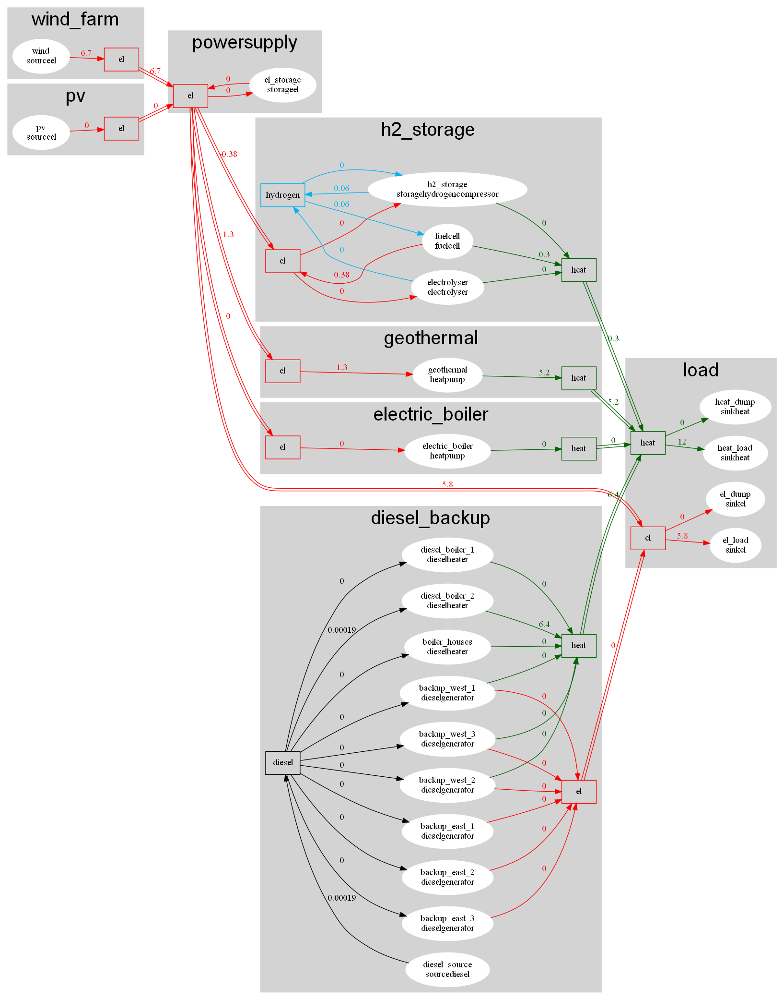

In [66]:
tstep=1602
gCombined = plots.plot_network(simulator=simulator,timestep=tstep,numberformat="{:.3g}",
                              filename=None,only_carrier=None,fontsize=30,fontname = "helvetica",
                              hide_losses=True)
IPython.display.Image(gCombined.create_png())
#gCombined.write_png(path=outpath+"diagram_{}.pdf".format(case),f="pdf")
#gCombined.write_pdf(path=outpath+"diagram_{}.pdf".format(case))

In [23]:
print(sim_result.device_flow.h2_storage.el["in"].to_string())

time
0       0.000000e+00
1       0.000000e+00
2       0.000000e+00
3       0.000000e+00
4       0.000000e+00
5       0.000000e+00
6       0.000000e+00
7       0.000000e+00
8       0.000000e+00
9       0.000000e+00
10      0.000000e+00
11      0.000000e+00
12      0.000000e+00
13      0.000000e+00
14      0.000000e+00
15      0.000000e+00
16      0.000000e+00
17      0.000000e+00
18      0.000000e+00
19      0.000000e+00
20      0.000000e+00
21      0.000000e+00
22      0.000000e+00
23      0.000000e+00
24      0.000000e+00
25      0.000000e+00
26      0.000000e+00
27      0.000000e+00
28      0.000000e+00
29      0.000000e+00
30      0.000000e+00
31      0.000000e+00
32      0.000000e+00
33      0.000000e+00
34      0.000000e+00
35      0.000000e+00
36      0.000000e+00
37      0.000000e+00
38      0.000000e+00
39      3.101499e-02
40      6.139998e-02
41      6.231126e-02
42      6.269291e-02
43      6.214754e-02
44      6.397413e-02
45      5.978150e-02
46      5.562279e-02
47      

In [24]:
for i in range(240):
    print(pyo.value(simulator.optimiser.varDeviceStorageEnergy["h2_storage",i]))

331367.5755597237
329690.1397866516
328810.97223292396
327919.18244615407
326974.21216722025
325443.6043246416
326010.7910237458
324280.4438146114
322673.40561010514
323837.88214030623
322118.6270187895
320172.2669648205
317388.49437409523
315615.558047792
313878.6809501041
312627.4683931137
312424.0252519841
313772.0403196756
315676.8737802352
318354.7210862353
319966.94354472065
321508.6008905095
320243.90012120415
318141.92040704045
315836.9460858878
313002.30041659647
311156.3004491971
312807.60133937804
315608.870959342
317622.94862075645
319244.6361656621
320081.561292957
317361.8320175481
314645.81150016567
311811.16583087435
312196.9570419547
315180.7687792781
318238.8529060967
321291.2551578299
324398.3739445705
323390.740143632
325909.1566581206
328819.7734644282
331890.5051800113
335058.96802349656
338092.50991781504
340857.5090875558
340570.52527012414
338997.4501599667
339744.3878630637
339221.32781333243
339468.73996668344
340142.4601166979
340785.3745495361
342145.017916

In [25]:
pyo.value(simulator.optimiser.paramDeviceEnergyInitially["h2_storage"])

330868.05049690546

In [26]:
sim_result.device_storage_energy.h2_storage

time
0       296535.296277
1       293191.902112
2       289475.251742
3       285970.202350
4       282532.110610
            ...      
8515    318354.721086
8516    319966.943545
8517    321508.600891
8518    320243.900121
8519    318141.920407
Length: 8520, dtype: float64

In [27]:
pyo.value(simulator.optimiser.varDeviceFlow["h2_storage","hydrogen","in",19])

0.7438464738889164

In [28]:
print(sim_result.device_flow.heat_dump.to_string())

carrier   terminal  time
diesel    in        0       0.000000
                    1       0.000000
                    2       0.000000
                    3       0.000000
                    4       0.000000
                    5       0.000000
                    6       0.000000
                    7       0.000000
                    8       0.000000
                    9       0.000000
                    10      0.000000
                    11      0.000000
                    12      0.000000
                    13      0.000000
                    14      0.000000
                    15      0.000000
                    16      0.000000
                    17      0.000000
                    18      0.000000
                    19      0.000000
                    20      0.000000
                    21      0.000000
                    22      0.000000
                    23      0.000000
                    24      0.000000
                    25      0.000000
             

In [29]:
#simulator.optimiser.all_nodes['wells'].devices_serial
#sim_result.dfEdgeFlow.unstack("edge").loc[151]
#simulator.optimiser.constrN_wells_energybalance["gas","out",0].pprint()
#print(pyo.value(simulator.optimiser.varDeviceFlow["wellL1","gas","out",0]))
#print(pyo.value(simulator.optimiser.varDeviceFlow["wellL2","gas","out",0]))
#print(pyo.value(simulator.optimiser.varEdgeFlow["cL2g",0]))
#print(pyo.value(simulator.optimiser.varEdgeLoss21["cL2g",0]))

In [30]:
combine = None
if incl_diesel: combine = [["diesel_generators"],[dieselgenerators]]

fig2=plots.plot_sum_power_mix(sim_result,simulator.optimiser,carrier="el",filename=None,devs_combine=combine,exclude_zero=True,dev_color_dict=device_color_dict)#,devs_shareload=dieselgenerators, exclude_zero=True)#['Gen1','Gen2','Gen3'])
#fig2.update_layout(autosize=False,width=800,height=500,margin=dict(l=0,r=0,t=0,b=0))
#fig2.write_image("{}/elpowermix_{}.png".format(outpath,case))
#fig2.set_size_inches(6,4)
plt.suptitle("")
fig2.show()
plt.savefig("result/poweroutputel_{}x.pdf".format(case),dpi=300,bbox_inches="tight")

<Figure size 432x288 with 0 Axes>

In [31]:
combine = None
if incl_diesel: combine = [["diesel_boilers"],[dieselboilers]]

fig2=plots.plot_sum_power_mix(sim_result,simulator.optimiser,carrier="heat",filename=None,devs_combine=combine,exclude_zero=True,dev_color_dict=device_color_dict)#,devs_shareload=dieselgenerators, exclude_zero=True)#['Gen1','Gen2','Gen3'])
#fig2.update_layout(autosize=False,width=800,height=500,margin=dict(l=0,r=0,t=0,b=0))
#fig2.write_image("{}/elpowermix_{}.png".format(outpath,case))
#fig2.set_size_inches(6,4)
plt.suptitle("")
fig2.show()
plt.savefig("result/poweroutputheat_{}x.pdf".format(case),dpi=300,bbox_inches="tight")

<Figure size 432x288 with 0 Axes>

In [32]:
plots.plotter="plotly"
gts = [d for d,d_obj in simulator.optimiser.all_devices.items() if d_obj.dev_data.model in ["dieselgenerator","source_el"]]
fig=plots.plot_device_profile(sim_result,simulator.optimiser,devs=gts,filename=None,include_on_off=True, include_prep=False,devs_shareload=None)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white",
                 title="Power supply and on/off status (case: {})".format(case))
fig.show()

,el,heat
device,,
backup_east_1,0.000000,0.000000
backup_east_2,0.000000,0.000000
backup_east_3,0.000000,0.000000
backup_west_1,0.000000,0.000000
backup_west_2,0.000000,0.000000
backup_west_3,0.000000,0.000000
boiler_houses,0.000000,0.000000
diesel_boiler_1,0.000000,0.000000
diesel_boiler_2,0.000000,0.000000


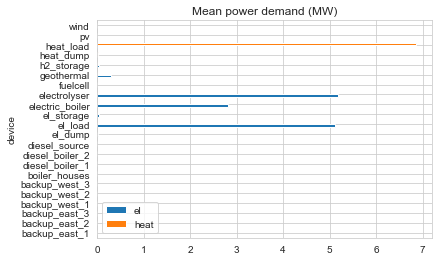

In [33]:
mean_el_demand = sim_result.device_flow.unstack('carrier')['el'].unstack('terminal')['in'].dropna().unstack().T.mean()
mean_heat_demand = sim_result.device_flow.unstack('carrier')['heat'].unstack('terminal')['in'].dropna().unstack().T.mean()
energydemand = pd.concat({'el':mean_el_demand,'heat':mean_heat_demand},axis=1)
#energydemand.drop('heatdump',inplace=True)
energydemand.plot.barh(title="Mean power demand (MW)")
energydemand

In [34]:
energydemand.sum()

el      13.505917
heat     6.882937
dtype: float64

In [35]:
mean_flows=sim_result.device_flow.unstack(["carrier","device","terminal"]).mean().unstack(["carrier","terminal"])
print("Mean flows:\n",mean_flows.sum())
print("Mean flow per device:")
mean_flows

Mean flows:
 carrier   terminal
diesel    in           0.000009
          out          0.000009
el        in          13.505917
          out         13.505917
heat      in           6.882937
          out          6.882937
hydrogen  in           0.594337
          out          0.594337
dtype: float64
Mean flow per device:


carrier                diesel                  el                heat  \
terminal                   in       out        in       out        in   
device                                                                  
backup_east_1    0.000000e+00  0.000000  0.000000  0.000000  0.000000   
backup_east_2    0.000000e+00  0.000000  0.000000  0.000000  0.000000   
backup_east_3    0.000000e+00  0.000000  0.000000  0.000000  0.000000   
backup_west_1    1.549557e-06  0.000000  0.000000  0.020453  0.000000   
backup_west_2    1.500819e-06  0.000000  0.000000  0.019853  0.000000   
backup_west_3    1.898449e-06  0.000000  0.000000  0.025131  0.000000   
boiler_houses    1.628025e-07  0.000000  0.000000  0.000000  0.000000   
diesel_boiler_1  1.989188e-06  0.000000  0.000000  0.000000  0.000000   
diesel_boiler_2  1.659314e-06  0.000000  0.000000  0.000000  0.000000   
diesel_source    0.000000e+00  0.000009  0.000000  0.000000  0.000000   
el_dump          0.000000e+00  0.000000  0.010106  0.000000  0.000000   
el_load          0.000000e+00  0.000000  5.121251  0.000000  0.000000   
el_storage       0.000000e+00  0.000000  0.043738  0.035792  0.000000   
electric_boiler  0.000000e+00  0.000000  2.812318  0.000000  0.000000   
electrolyser     0.000000e+00  0.000000  5.175066  0.000000  0.000000   
fuelcell         0.000000e+00  0.000000  0.000000  1.885143  0.000000   
geothermal       0.000000e+00  0.000000  0.298394  0.000000  0.000000   
h2_storage       0.000000e+00  0.000000  0.045045  0.000000  0.000000   
heat_dump        0.000000e+00  0.000000  0.000000  0.000000  0.027238   
heat_load        0.000000e+00  0.000000  0.000000  0.000000  6.855699   
pv               0.000000e+00  0.000000  0.000000  1.841265  0.000000   
wind             0.000000e+00  0.000000  0.000000  9.678280  0.000000   

carrier                    hydrogen            
terminal              out        in       out  
device                                         
backup_east_1    0.000000  0.000000  0.000000  
backup_east_2    0.000000  0.000000  0.000000  
backup_east_3    0.000000  0.000000  0.000000  
backup_west_1    0.023002  0.000000  0.000000  
backup_west_2    0.022253  0.000000  0.000000  
backup_west_3    0.028138  0.000000  0.000000  
boiler_houses    0.005346  0.000000  0.000000  
diesel_boiler_1  0.066737  0.000000  0.000000  
diesel_boiler_2  0.055670  0.000000  0.000000  
diesel_source    0.000000  0.000000  0.000000  
el_dump          0.000000  0.000000  0.000000  
el_load          0.000000  0.000000  0.000000  
el_storage       0.000000  0.000000  0.000000  
electric_boiler  2.784194  0.000000  0.000000  
electrolyser     1.190265  0.000000  0.297464  
fuelcell         1.508115  0.296873  0.000000  
geothermal       1.193575  0.000000  0.000000  
h2_storage       0.005642  0.297464  0.296873  
heat_dump        0.000000  0.000000  0.000000  
heat_load        0.000000  0.000000  0.000000  
pv               0.000000  0.000000  0.000000  
wind             0.000000  0.000000  0.000000

In [36]:
plots.plotter="plotly"
gts = [d for d,d_obj in simulator.optimiser.all_devices.items() if d_obj.dev_data.model in ["sourceel"]]
fig=plots.plot_device_profile(sim_result,simulator.optimiser,devs=gts,filename=None,include_on_off=False,include_prep=False,devs_shareload=None)
#fig.update_layout(autosize=False,width=700,height=300,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.show()
#300 dpi and 4 inch: 1200 pixels
scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"powersupply.pdf",width=700,height=300,scale=scale)

In [37]:
df = sim_result.device_flow.unstack(["carrier", "terminal"])[("el", "out")].unstack("device")
df.index

Int64Index([   0,    1,    2,    3,    4,    5,    6,    7,    8,    9,
            ...
            8510, 8511, 8512, 8513, 8514, 8515, 8516, 8517, 8518, 8519],
           dtype='int64', name='time', length=8520)

In [38]:
import plotly
fig = plotly.subplots.make_subplots(rows=1, cols=1, shared_xaxes=True)
if incl_wind:
    fig.add_scatter(
                    x=df.index,
                    y=df["wind"],
                    line_shape="hv",
                    name="wind",
                    #line=dict(color=colour[k]),
                    stackgroup="P",
                    legendgroup="wind",
                    row=1,
                    col=1,
                )

In [39]:
dfStartopt = pd.DataFrame()
inst=simulator.optimiser
for t in inst.setHorizon: 
    if incl_wind: dfStartopt.loc[t,'start']=inst.varDeviceStarting['wind',t].value
    if incl_geothermal: dfStartopt.loc[t,'prep']=inst.varDeviceIsPrep['geothermal',t].value
    if incl_hydrogen: 
        dfStartopt.loc[t,'on']=inst.varDeviceIsOn['electrolyser',t].value
        dfStartopt.loc[t,'stop']=inst.varDeviceStopping['fuelcell',t].value
dfStartopt.head()

,start,prep,on,stop
0,NaN,0.0,1.0,NaN
1,NaN,0.0,1.0,NaN
2,NaN,0.0,1.0,NaN
3,NaN,0.0,1.0,NaN
4,NaN,0.0,1.0,NaN


In [40]:
if incl_wind:
    fig=plots.plot_device_profile(sim_result,simulator.optimiser,devs=['wind'],filename=None,include_forecasts=True)
    fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=0,b=0))

In [41]:
"""
df=sim_result.device_flow.unstack([0,1,2])[[('ex_g','gas','in'),('ex_o','oil','in')]]
df.columns=['gas','oil']
df=df.reset_index()
df["gas"]=df["gas"]/1000 # convert to oil equivalents
df = df.melt(var_name="Product",value_name="Volume rate (Sm3oe/s)",id_vars=('time'))
px.line(df,x="time",y="Volume rate (Sm3oe/s)",color="Product",title="Oil/gas export volumes (Sm3oe/s)").show()

plots.plot_export_revenue(sim_result)
"""

'\ndf=sim_result.device_flow.unstack([0,1,2])[[(\'ex_g\',\'gas\',\'in\'),(\'ex_o\',\'oil\',\'in\')]]\ndf.columns=[\'gas\',\'oil\']\ndf=df.reset_index()\ndf["gas"]=df["gas"]/1000 # convert to oil equivalents\ndf = df.melt(var_name="Product",value_name="Volume rate (Sm3oe/s)",id_vars=(\'time\'))\npx.line(df,x="time",y="Volume rate (Sm3oe/s)",color="Product",title="Oil/gas export volumes (Sm3oe/s)").show()\n\nplots.plot_export_revenue(sim_result)\n'

In [42]:
simulator.optimiser.setDevice.pprint()

setDevice : device
    Size=1, Index=None, Ordered=Insertion
    Key  : Dimen : Domain : Size : Members
    None :     1 :    Any :   22 : {'wind', 'pv', 'el_load', 'heat_load', 'electrolyser', 'fuelcell', 'h2_storage', 'el_storage', 'geothermal', 'electric_boiler', 'heat_dump', 'el_dump', 'diesel_source', 'backup_east_1', 'backup_east_2', 'backup_east_3', 'backup_west_1', 'backup_west_2', 'backup_west_3', 'diesel_boiler_1', 'diesel_boiler_2', 'boiler_houses'}


In [43]:
plots.plotter="plotly"
if 'el_storage' in simulator.optimiser.setDevice:
    fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,'el_storage',filename=None,dev_color_dict=device_color_dict)#outpath+"battery_opt.png")
    fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=30,b=0)).show()
#    oogeso.plots.optimization_plots.plot_device_power_last_optimisation_1(mc,device='battery', filename=None)#outpath+"lastopt_battery.png")

In [44]:
plots.plotter="plotly"
if 'h2_storage' in simulator.optimiser.setDevice:
    fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,'h2_storage',filename=None,dev_color_dict=device_color_dict)#outpath+"battery_opt.png")
    #fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=30,b=0)).show()
    fig.show()

In [45]:
sim_result.device_flow["h2_storage", "el"].unstack("terminal")[0:10]

terminal,in,out
time,,
0,0.0,0.0
1,0.0,0.0
2,0.0,0.0
3,0.0,0.0
4,0.0,0.0
5,0.0,0.0
6,0.0,0.0
7,0.0,0.0
8,0.0,0.0


In [46]:
sim_result.device_storage_energy.h2_storage

time
0       296535.296277
1       293191.902112
2       289475.251742
3       285970.202350
4       282532.110610
            ...      
8515    318354.721086
8516    319966.943545
8517    321508.600891
8518    320243.900121
8519    318141.920407
Length: 8520, dtype: float64

In [47]:
plots.plotter="plotly"
fig=plots.plot_CO2_rate_per_device(sim_result,simulator.optimiser,reverse_legend=True,filename=outpath+"co2rate_opt.png",dev_color_dict=device_color_dict)#,device_shareload=gts)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [48]:
plots.plotter="plotly"
combine = None
if incl_diesel: combine = [["diesel_generators", "diesel_boilers"],[dieselgenerators, dieselboilers]]

fig=plots.plot_CO2_rate_per_device(sim_result,simulator.optimiser,reverse_legend=True,filename=outpath+"co2rate_opt_combine.png",device_combine=combine,dev_color_dict=device_color_dict)#,device_shareload=gts)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [49]:
fig = plots.plot_CO2_rate(sim_result)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [50]:
fig = plots.plot_op_cost(sim_result)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [51]:
plots.plotter="plotly"
combine = None

fig=plots.plot_op_cost_per_device(sim_result,simulator.optimiser,reverse_legend=True,filename=outpath+"co2rate_opt_combine.png",device_combine=combine,dev_color_dict=device_color_dict)#,device_shareload=gts)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [52]:
sim_result.op_cost_per_dev.el_storage.sum()*3600

5347.601013489609

In [53]:
plots.plotter="plotly"
combine = None
if incl_diesel: combine = [["diesel_generators", "diesel_boilers"],[dieselgenerators, dieselboilers]]

fig=plots.plot_op_cost_per_device(sim_result,simulator.optimiser,reverse_legend=True,filename=outpath+"co2rate_opt_combine.png",device_combine=combine,dev_color_dict=device_color_dict)#,device_shareload=gts)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [54]:
fig = plots.plot_all_costs(sim_result, simulator.optimiser)
fig.show()

In [55]:
fig = plots.plot_all_costs_per_device(sim_result, simulator.optimiser, include_sum=True)
fig.show()

2158461.116003528


In [56]:
if incl_diesel: combine = [["diesel_generators", "diesel_boilers"],[dieselgenerators, dieselboilers]]
fig = plots.plot_all_costs_per_device(sim_result, simulator.optimiser, include_sum=True, device_combine=combine)
fig.show()

2158461.116003528


In [57]:
sim_result.co2_rate

0       0.0
1       0.0
2       0.0
3       0.0
4       0.0
       ... 
8515    0.0
8516    0.0
8517    0.0
8518    0.0
8519    0.0
Length: 8520, dtype: float64

In [58]:
plots.plotter="plotly"
fig=plots.plot_reserve(sim_result,simulator.optimiser,dynamic_margin=True,include_sum=False,dev_color_dict=device_color_dict)
#plt.legend(loc="upper left",bbox_to_anchor=(1,1),frameon=False)
#fig.set_size_inches(5.92,1.5)
#plt.savefig("result/reserve_{}x.pdf".format(case),dpi=300,bbox_inches="tight")
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.update_layout(legend_traceorder="reversed")
fig.show()
#300 dpi and 4 inch: 1200 pixels
#scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"reserve.pdf",width=700,height=200,scale=scale)

In [59]:
plots.plotter="plotly"
combine = [["diesel_generators"],[dieselgenerators]]

fig=plots.plot_reserve(sim_result,simulator.optimiser,dynamic_margin=True,include_sum=False,device_combine=combine,dev_color_dict=device_color_dict)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.update_layout(legend_traceorder="reversed")
fig.show()
#300 dpi and 4 inch: 1200 pixels
#scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"reserve.pdf",width=700,height=200,scale=scale)

In [60]:
# This plot shows per device its output (dotted line) and the available online backup, iel reserve 
# by _other_ devices (solid line). MARGIN(t) = min_devices(backup(t) - output(t))
plots.plot_el_backup(sim_result,show_margin=True,return_margin=False)

In [61]:
if incl_hydrogen:
    fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,"h2_storage")
    fig.update_layout(autosize=False,width=800,height=250,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
    fig.update_yaxes(tick0=0, dtick=1,secondary_y=True,range=[0,5.5])
    fig.update_yaxes(tick0=0, dtick=100e3,secondary_y=False,range=[0,550e3])
    fig.show()
    fig.write_image(outpath+"h2_storage_{}.pdf".format(case))

In [62]:
sim_result.el_backup.unstack("device")

device,backup_east_1,backup_east_2,backup_east_3,backup_west_1,backup_west_2,backup_west_3,el_storage,fuelcell,pv,wind
time,,,,,,,,,,
0,3.888648,3.888648,3.888648,3.888648,3.888648,3.888648,3.888648,0.000000,3.888648,3.888648
1,4.102624,4.102624,4.102624,4.102624,4.102624,4.102624,4.102624,0.000000,4.102624,4.102624
2,3.444242,3.444242,3.444242,3.444242,3.444242,3.444242,3.444242,0.000000,3.444242,3.444242
3,3.817482,3.817482,3.817482,3.817482,3.817482,3.817482,3.817482,0.000000,3.817482,3.817482
4,3.935588,3.935588,3.935588,3.935588,3.935588,3.935588,3.935588,0.000000,3.935588,3.935588
...,...,...,...,...,...,...,...,...,...,...
8515,22.940891,22.940891,22.940891,22.940891,22.940891,22.940891,22.940891,12.940891,22.940891,22.940891
8516,17.791182,17.791182,17.791182,17.791182,17.791182,17.791182,17.791182,7.791182,17.791182,17.791182
8517,17.450171,17.450171,17.450171,17.450171,17.450171,17.450171,17.450171,7.450171,17.450171,17.450171


In [63]:
simulator.profiles["nowcast"]

,el_load,heat_load,V47,V105,PV,geothermal
0,4.73,9.488144,0.186553,0.135162,0.0,1.0
1,4.12,9.581248,0.178963,0.129818,0.0,1.0
2,4.46,9.522000,0.124212,0.092126,0.0,1.0
3,4.38,9.225760,0.142042,0.104367,0.0,1.0
4,4.43,8.963376,0.143642,0.104305,0.0,1.0
...,...,...,...,...,...,...
8755,5.26,10.139872,0.313144,0.234353,0.0,1.0
8756,5.16,9.826704,0.102337,0.079914,0.0,1.0
8757,5.12,9.640496,0.156202,0.120718,0.0,1.0
8758,4.99,9.513536,0.730944,0.723163,0.0,1.0


In [64]:
fig = plots.plot_unused_profile_power(simulator)
fig.show()